<a href="https://colab.research.google.com/github/abeerm24/EE-610-assignments-2022/blob/main/EE610_assignment3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Name: Abeer Mishra       Roll No.: 200260001

Name: Mayank Agrawal     Roll No.: 200260028

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt

# Q1

In [ ]:
# Load the input image
!wget 'https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/dr-strange.png' #Downloads the file from git repo

--2022-10-15 16:17:03--  https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/dr-strange.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 430676 (421K) [image/png]
Saving to: ‘dr-strange.png.1’

dr-strange.png.1    100%[===================>] 420.58K  --.-KB/s    in 0.02s   

2022-10-15 16:17:03 (18.3 MB/s) - ‘dr-strange.png.1’ saved [430676/430676]



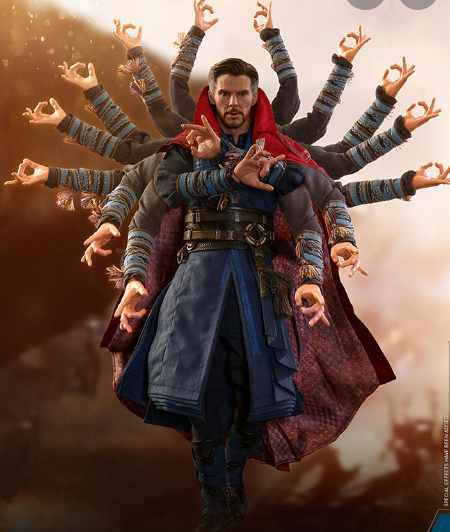

In [ ]:
#Display the input image
inputImg = cv2.imread('dr-strange.png')
cv2_imshow(inputImg)

# A. Write function for Additive White Gaussian noise (AWGN)

In [ ]:
def AWGN(image,variance):
  '''
  Returns an image (numpy array) with Additive White Gaussian Noise.
  :param image: A numpy array of dimensions (N,M,3) - for RGB images or (N,M) - for grayscale images
  :param variance: Variance of the noise to be added. Can be int or float
  '''
  # Copy the input image
  outputImg = image.copy()



  if len(image.shape)==3: # Color image with 3 channels
    noise = np.random.normal(scale=variance,size=image.shape) # Generate the AWGN
    # Souce: https://numpy.org/doc/stable/reference/random/generated/numpy.random.normal.html


  elif len(image.shape)==2: # Black and white image with no channels: just pixel intensity values
    noise = np.random.normal(scale=variance,size=image.shape) # Generate the AWGN

  else:
    # Raise error to handle invalid format
    raise Exception("Invalid input format!")

  noise = np.uint8(noise)
  outputImg += noise # Add the noise to the image
  return np.uint8(outputImg) # Convert the image to the 8 bit integer format before returning

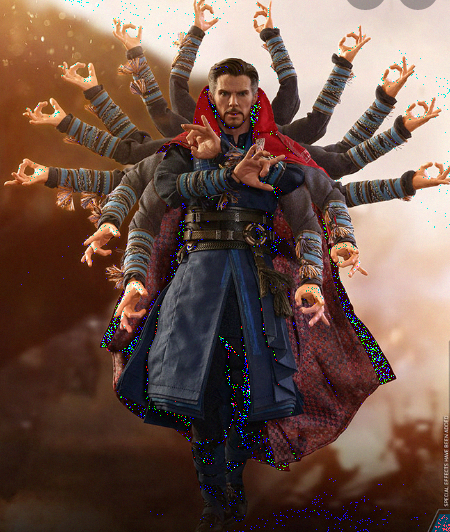

In [ ]:
# Randomly choose a variance between 0-5 for the noise
variance = 5*np.random.rand()
awgn_img = AWGN(inputImg,variance)
cv2_imshow(awgn_img)

In [ ]:
print(variance)

2.772771973080477


# B. Define PSNR function and measure the PSNR between a restored image and the ground truth image.


To remove the noise first I attempted to work in HSV space but that wasn't very helpful. So I decided to work with the RGB space which had some interesting results.

In [ ]:
def PSNR(distImg, origImg, peak=255):
  '''
  Returns the peak signal-to-noise ratio for given distorted image and original image
  :param distImg: A numpy array (shape: (N,M,C) or (N,M)) for the distorted image
  :param origImg: A numpy array (shape: (N,M,C) or (N,M)) for the original image
  :param peak: An int value which is the peak signal (default = 255)
  '''
  # Calculate mean squarred error (MSE)
  if distImg.shape==origImg.shape:
    mse = np.mean(np.square(distImg-origImg))
  else:
    raise Exception("Input shapes do not match!")

  # Compute PSNR
  psnr = 10*np.log(peak**2/mse)
  return psnr

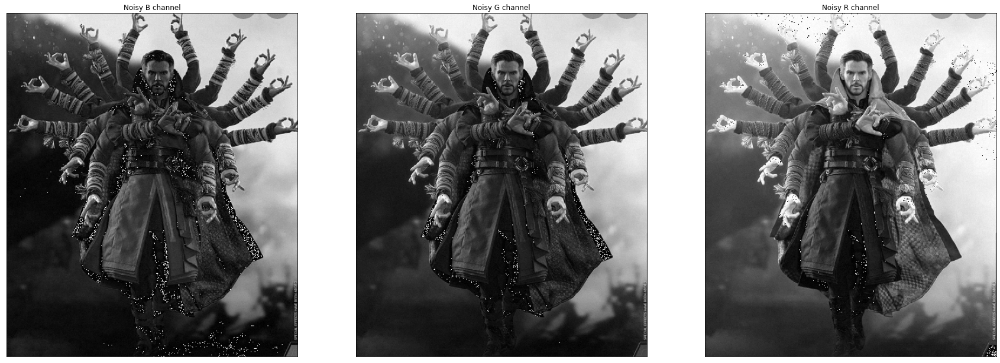

In [ ]:
f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)

# Extract B,G,R channels
Noisy_B = awgn_img[:,:,0]
Noisy_G = awgn_img[:,:,1]
Noisy_R = awgn_img[:,:,2]

# Display the H,S,V channels
plt.subplot(131),plt.imshow(Noisy_B, cmap = 'gray')
plt.title('Noisy B channel'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(Noisy_G, cmap = 'gray')
plt.title('Noisy G channel'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(Noisy_R, cmap = 'gray')
plt.title('Noisy R channel'), plt.xticks([]), plt.yticks([])
plt.axis('on')
plt.show()

In case of the 3 images, we can observe that, the noise is like salt noise for the blue channel and green channel.

In case of the R channel we get salt noise in the lower half of the image and pepper noise in the upper half of the image.

Based on this information, initially I tried to use a min filter for the blue channel, green channel and lower half of the image red channel; and a max filter for the upper half of the red channel of the image. But that didn't work very well as that spoiled the color balance overall and sort of "red-shifted" the image.

So I decided to go ahead with simple median filtering. Based on trial and error, I found a kernel size of 5 to work the best.

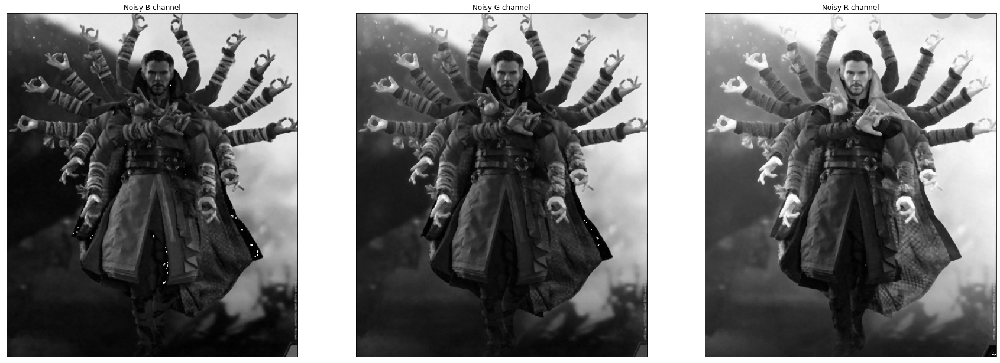

In [ ]:
blurredR = cv2.medianBlur(Noisy_R, 3)
blurredG = cv2.medianBlur(Noisy_G, 3)
blurredB = cv2.medianBlur(Noisy_B, 3)

f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)

# Display the H,S,V channels
plt.subplot(131),plt.imshow(blurredB, cmap = 'gray')
plt.title('Noisy B channel'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(blurredG, cmap = 'gray')
plt.title('Noisy G channel'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(blurredR, cmap = 'gray')
plt.title('Noisy R channel'), plt.xticks([]), plt.yticks([])
plt.show()

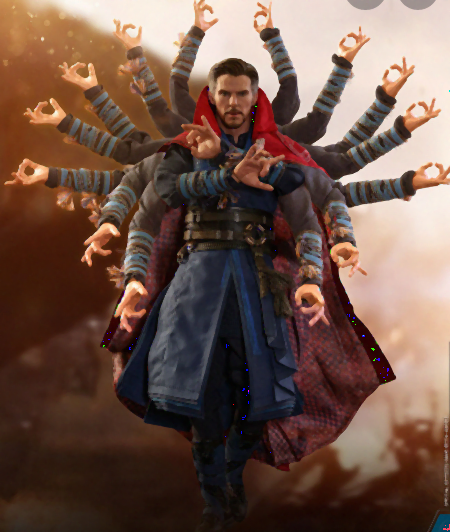

In [ ]:

# Add the channels together to construct the denoised image
denoisedImg = awgn_img.copy()
denoisedImg[:,:,0] = blurredB
denoisedImg[:,:,1] = blurredG
denoisedImg[:,:,2] = blurredR

cv2_imshow(denoisedImg)

In [ ]:
# Compute and print psnr
psnr = PSNR(denoisedImg,inputImg)
print(psnr)

81.43236327091122


# C. Define and measure SSIM between restored and ground truth image.

To compute SSIM, I will be using the formula given on this page:

https://medium.com/srm-mic/all-about-structural-similarity-index-ssim-theory-code-in-pytorch-6551b455541e

In [ ]:
def SSIM(distImg, origImg, C1=1, C2=1, C3 = 0.5,alpha=1,beta=1,gamma=1):
  '''
  Returns the structural similarity index for given distorted image and original image
  :param distImg: A numpy array (shape: (N,M,C) or (N,M)) for the distorted image
  :param origImg: A numpy array (shape: (N,M,C) or (N,M)) for the original image
  :param C1,C2,C3: non-zero int or float values (default values: 1,1,0.5)
  :param alpha, beta, gamma: float values (by default all are 1)
  '''
  mu_x = np.mean(distImg)
  mu_y = np.mean(origImg)

  # Compute the covariance matrix of the 2 arrays
  std_x = np.var(distImg)**0.5 # Standard deviation of x
  std_y = np.var(origImg)**0.5 # standard deviation of y
  var_xy= np.cov(distImg.flatten(),origImg.flatten())[0][1] # Covariance of x and y
  # Source: https://www.geeksforgeeks.org/compute-the-covariance-matrix-of-two-given-numpy-arrays/

  l = (2*mu_x*mu_y + C1)/(mu_x**2 + mu_y**2 + C1)
  c = (2*std_x*std_y + C2)/(std_x**2 + std_y**2 + C2)
  s = (var_xy + C3)/(std_x*std_y + C3)

  ssim = (l**alpha)*(c**beta)*(s**gamma)

  return ssim

In [ ]:
# Compute and print SSIM
ssim = SSIM(denoisedImg,inputImg)
print(ssim)

0.9925019888002206


# D. Function to implement gaussian low pass filtering

In [ ]:
def GLPF(img, var):
  '''
  Function to implement Gaussian Low Pass Filter on the img.
  :param img: A numpy array of dimensions (N,M) for grayscale or (N,M,3) for color images
  Returns a numpy array of same shape as img
  '''
  if len(img.shape)==2:
    # Take fourier transform
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    # Source: https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_transforms/py_fourier_transform/py_fourier_transform.html

    # Find the center of the image
    cen_x, cen_y = img.shape[0]/2,img.shape[1]/2

    # Create a gaussian kernel the size of the image
    gaussian = np.zeros(img.shape)
    for x in range(img.shape[0]):
      for y in range(img.shape[1]):
        dist2 = (cen_x - x)**2 + (cen_y - y)**2 # Square of distance from center
        gaussian[x][y] = np.exp(-dist2/(2*(var**2)))

    # Apply GLPF
    outputImgF = np.multiply(fshift,gaussian)

    # Take inverse fourier transform
    f_ishift = np.fft.ifftshift(outputImgF)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back)
    outputImg = np.uint8(img_back)

  elif len(img.shape)==3:
    outputImg = img.copy() # Create an array to store the output image

    # Apply Fourier transform and GLPF on each channel
    for i in range(3):
      # Take fourier transform
      f = np.fft.fft2(img[:,:,i])
      fshift = np.fft.fftshift(f)

      # Find the center of the image
      cen_x, cen_y = img.shape[0]/2,img.shape[1]/2

      # Create a gaussian kernel the size of the image
      gaussian = np.zeros((img.shape[0],img.shape[1]))
      for x in range(img.shape[0]):
        for y in range(img.shape[1]):
          dist2 = (cen_x - x)**2 + (cen_y - y)**2 # Square of distance from center
          gaussian[x][y] = np.exp(-dist2/(2*(var**2)))

      # Apply GLPF
      outputImgF = np.multiply(fshift,gaussian)

      # Take inverse fourier transform
      f_ishift = np.fft.ifftshift(outputImgF)
      img_back = np.fft.ifft2(f_ishift)
      img_back = np.abs(img_back)
      outputImg[:,:,i] = np.uint8(img_back)

  else:
    raise Exception("Invalid input!")

  return outputImg



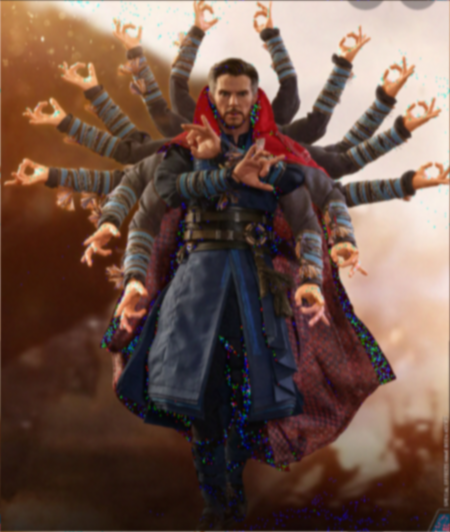

In [ ]:
# Apply GLPF on the noisy image
gaussImg = GLPF(awgn_img,70)
cv2_imshow(gaussImg)

# Q2

## Performing wavlet transform on channels of AWGN added image

I will be using the pywt library for performing DWT and IDWT.

Source: https://pywavelets.readthedocs.io/en/latest/ref/2d-dwt-and-idwt.html

In [ ]:
import pywt

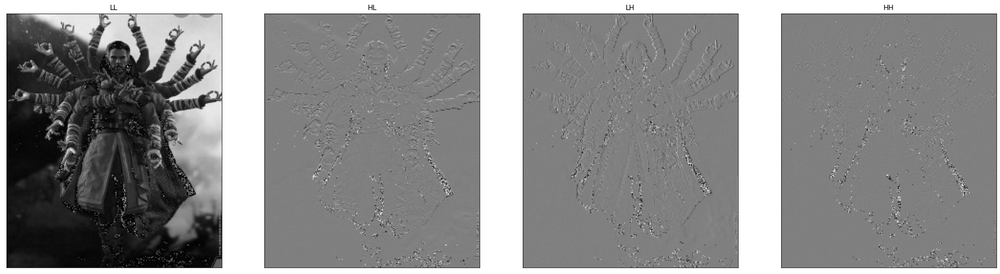

In [ ]:
# Perform DWT for blue channel

coeffs = pywt.dwt2(Noisy_B, 'haar')
bcA, (bcH, bcV, bcD) = coeffs

# Display the results
f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)

plt.subplot(141),plt.imshow(bcA, cmap = 'gray')
plt.title('LL'), plt.xticks([]), plt.yticks([])
plt.subplot(142),plt.imshow(bcH, cmap = 'gray')
plt.title('HL'), plt.xticks([]), plt.yticks([])
plt.subplot(143),plt.imshow(bcV, cmap = 'gray')
plt.title('LH'), plt.xticks([]), plt.yticks([])
plt.subplot(144),plt.imshow(bcD, cmap = 'gray')
plt.title('HH'), plt.xticks([]), plt.yticks([])
plt.show()

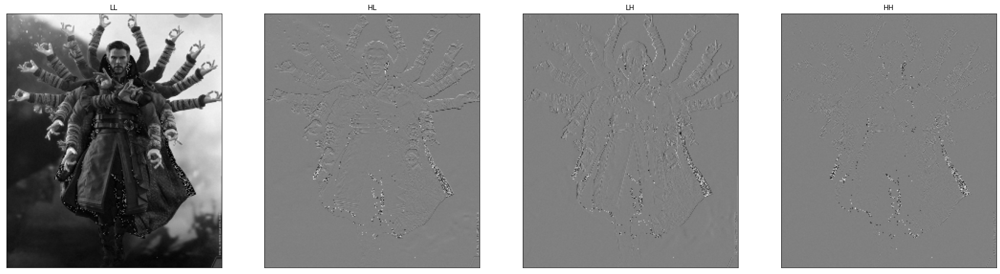

In [ ]:
# Perform DWT for green channel

coeffs = pywt.dwt2(Noisy_G, 'haar')
gcA, (gcH, gcV, gcD) = coeffs

# Display the results

f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)

plt.subplot(141),plt.imshow(gcA, cmap = 'gray')
plt.title('LL'), plt.xticks([]), plt.yticks([])
plt.subplot(142),plt.imshow(gcH, cmap = 'gray')
plt.title('HL'), plt.xticks([]), plt.yticks([])
plt.subplot(143),plt.imshow(gcV, cmap = 'gray')
plt.title('LH'), plt.xticks([]), plt.yticks([])
plt.subplot(144),plt.imshow(gcD, cmap = 'gray')
plt.title('HH'), plt.xticks([]), plt.yticks([])
plt.show()

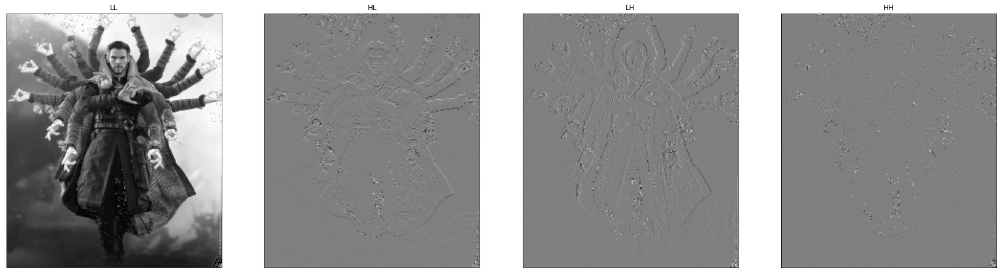

In [ ]:
# Perform DWT for red channel

coeffs = pywt.dwt2(Noisy_R, 'haar')
rcA, (rcH, rcV, rcD) = coeffs

# Display the results

f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)

plt.subplot(141),plt.imshow(rcA, cmap = 'gray')
plt.title('LL'), plt.xticks([]), plt.yticks([])
plt.subplot(142),plt.imshow(rcH, cmap = 'gray')
plt.title('HL'), plt.xticks([]), plt.yticks([])
plt.subplot(143),plt.imshow(rcV, cmap = 'gray')
plt.title('LH'), plt.xticks([]), plt.yticks([])
plt.subplot(144),plt.imshow(rcD, cmap = 'gray')
plt.title('HH'), plt.xticks([]), plt.yticks([])
plt.show()

# A. Perform Hard thresholding

In [ ]:
def hard_thresh_denoise(img,thresh):
  '''
  Returns image after denoising using hard thresholding on the wavelet transforms
  '''
  outputImg = img.copy()
  for channel in range(3):           # Select one channel of the image at a time
    img_channel = img[:,:,channel]

    # Perform wavelet transform
    coeffs = pywt.dwt2(img_channel, 'haar')
    cA, (cH, cV, cD) = coeffs

    #Perform hard thresholding on the wavelet transforms
    for x in range(cH.shape[0]):
      for y in range(cH.shape[1]):
        if abs(cH[x][y]) < thresh: cH[x][y] = 0
        if abs(cV[x][y]) < thresh: cV[x][y] = 0
        if abs(cD[x][y]) < thresh: cD[x][y] = 0

    # Apply GLPF on the LL wavelet
    #cA = GLPF(cA,50)

    # Set the new wavelet coefficients and take IDWT
    new_coeffs = (cA,(cH,cV,cD))
    img_channel_new = pywt.idwt2(new_coeffs, 'haar')

    outputImg[:,:,channel] = img_channel_new

  return outputImg

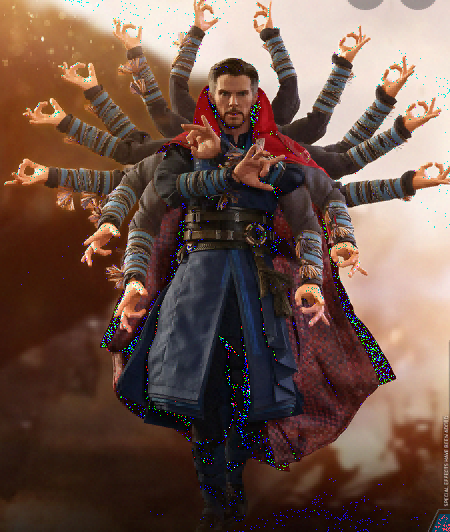

In [ ]:
cv2_imshow(hard_thresh_denoise(awgn_img, 10*np.sqrt(4*np.log(n))))

# B. Soft thresholding function

In [ ]:
def soft_thresh_denoise(img,thresh_HL=30,thresh_LH=30,thresh_HH=30):
  '''
  Returns image after denoising using hard thresholding on the wavelet transforms
  '''
  outputImg = img.copy()
  for channel in range(3):           # Select one channel of the image at a time
    img_channel = img[:,:,channel]

    # Perform wavelet transform
    coeffs = pywt.dwt2(img_channel, 'haar')
    cA, (cH, cV, cD) = coeffs

    #Perform hard thresholding on the wavelet transforms
    for x in range(cH.shape[0]):
      for y in range(cH.shape[1]):
        if cH[x][y] < thresh_HL: cH[x][y] = 0
        elif cH[x][y] >= thresh_HL: cH[x][y] -= thresh_HL
        if cV[x][y] < thresh_LH: cV[x][y] = 0
        elif cH[x][y] >= thresh_LH: cV[x][y] -= thresh_LH
        if cD[x][y] < thresh_HH: cD[x][y] = 0
        elif cH[x][y] >= thresh_HH: cD[x][y] -= thresh_HH

    # Set the new wavelet coefficients and take IDWT
    new_coeffs = (cA,(cH,cV,cD))
    img_channel_new = pywt.idwt2(new_coeffs, 'haar')

    outputImg[:,:,channel] = img_channel_new

  return outputImg

# C. The method proposed in the paper “Image Denoising using Neighbouring Wavelet Coefficients” by Chen et al.

In [ ]:
def neighShrink(img,sigma=2.5,n=3):
  '''
  Function to apply the neigh shrink method to denoise a color image
  :param img: numpy array of shape (N,M,3)
  :param sigma: A float variable; variance of the noise (by default taking it to be 2.5)
  :param n: An integer denoting window size for applying neighShrink (by default taking it to be 3)
  Returns a numpy array of the same shape as img
  '''
  if len(img.shape)==3:
    outputImg = img.copy()
    for channel in range(3):
      # Perform wavelet transform for each channel
      img_channel = img[:,:,channel]

      # Perform wavelet transform
      coeffs = pywt.dwt2(img_channel, 'haar')
      cA, (cH, cV, cD) = coeffs

      # Calculate the universal threshold lambda
      lmda_sq = 4*(sigma**2)*np.log(n) # λ=𝜎sqrt(2log𝑛2)

      for i in range(cH.shape[0]):
        for j in range(cH.shape[1]):
          S_sq = 0
          for x in range(-1,2,1):
            for y in range(-1,2,1):
              if (i+x in range(cA.shape[0]) and j+y in range(cA.shape[1])):
                S_sq += cH[i+x][j+y]**2
          B = (1 - lmda_sq/(S_sq))

          if B<0: B = 0
          cH[i][j] *= B

      for i in range(cV.shape[0]):
        for j in range(cV.shape[1]):
          S_sq = 0
          for x in range(-1,2,1):
            for y in range(-1,2,1):
              if (i+x in range(cV.shape[0]) and j+y in range(cV.shape[1])):
                S_sq += cV[i+x][j+y]**2
          B = (1 - lmda_sq/(S_sq))

          if B<0: B = 0
          cV[i][j] *= B

      for i in range(cD.shape[0]):
        for j in range(cD.shape[1]):
          S_sq = 0
          for x in range(-1,2,1):
            for y in range(-1,2,1):
              if (i+x in range(cD.shape[0]) and j+y in range(cD.shape[1])):
                S_sq += cD[i+x][j+y]**2
          B = (1 - lmda_sq/(S_sq))

          if B<0: B = 0
          cD[i][j] *= B

      # Set the new wavelet coefficients and take IDWT
      new_coeffs = (cA,(cH,cV,cD))
      outputImg[:,:,channel] = pywt.idwt2(new_coeffs, 'haar')

  elif len(img.shape)==2:
    # Perform wavelet transform

    # Perform wavelet transform
    coeffs = pywt.dwt2(img, 'haar')
    cA, (cH, cV, cD) = coeffs

    # Calculate the universal threshold lambda
    lmda_sq = 4*(sigma**2)*np.log(n) # λ=𝜎sqrt(2log𝑛2)

    for i in range(cH.shape[0]):
      for j in range(cH.shape[1]):
        S_sq = 0
        for x in range(-int(n/2),int(n/2)+1,1):
          for y in range(-int(n/2),int(n/2)+1,1):
            if i+x>=0 and i+x<cH.shape[0]:
              if j+y>=0 and j+y<cH.shape[1]:
                S_sq += cH[i+x][j+y]**2
        B = (1 - lmda_sq/S_sq)

        if B<0: B = 0
        cH[i][j] *= B

    for i in range(cV.shape[0]):
      for j in range(cV.shape[1]):
        S_sq = 0
        for x in range(-1,2,1):
          for y in range(-1,2,1):
            if i+x>=0 and i+x<cH.shape[0]:
              if j+y>=0 and j+y<cH.shape[1]:
                S_sq += cV[i+x][j+y]**2
        B = (1 - lmda_sq/S_sq)

        if B<0: B = 0
        cV[i][j] *= B

    for i in range(cD.shape[0]):
      for j in range(cD.shape[1]):
        S_sq = 0
        for x in range(-1,2,1):
          for y in range(-1,2,1):
            if i+x>=0 and i+x<cH.shape[0]:
              if j+y>=0 and j+y<cH.shape[1]:
                S_sq += cD[i+x][j+y]**2
        B = (1 - lmda_sq/S_sq)

        if B<0: B = 0
        cD[i][j] *= B

    # Set the new wavelet coefficients and take IDWT
    new_coeffs = (cA,(cH,cV,cD))
    outputImg = pywt.idwt2(new_coeffs, 'haar')

  return outputImg

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: divide by zero encountered in double_scalars


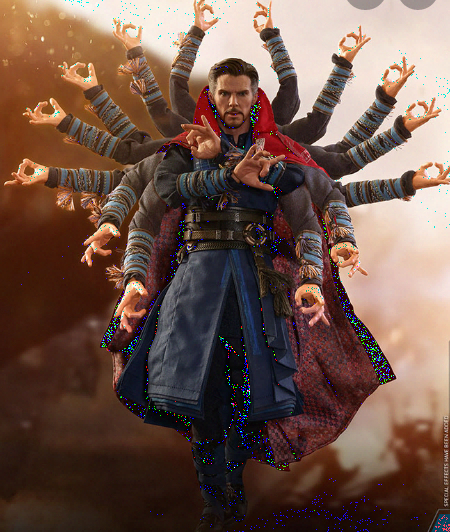

In [ ]:
neighShrinkImg = neighShrink(awgn_img,variance) # Apply the neighShrink algorithm
cv2_imshow(neighShrinkImg) # Display the image

In [ ]:
print("PSNR for NeighShrink ",PSNR(neighShrinkImg, inputImg))
print("PSNR for original AWGN image ",PSNR(awgn_img,inputImg))

PSNR for NeighShrink  96.32301705100572
PSNR for original AWGN image  93.28966170484001


# Q3. Compare SSIM and PSNR plots when:

# A. Adding AWGN with varying noise variance

In [ ]:
# Create an array of variances from 0 to 10
noiseVar = np.linspace(1,50,50)

a_psnr_vals = np.zeros(50)
a_ssim_vals = np.zeros(50)

for i in range(50):
  var = noiseVar[i]
  noisyImg = AWGN(inputImg,var)
  psnr = PSNR(noisyImg,inputImg)
  ssim = SSIM(noisyImg,inputImg)
  a_psnr_vals[i] = psnr
  a_ssim_vals[i] = ssim

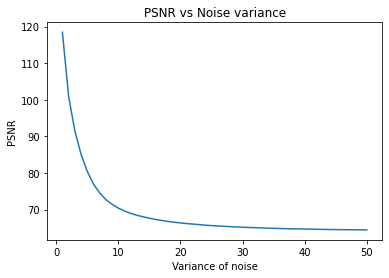

In [ ]:
# Plot PSNR

plt.plot(noiseVar,a_psnr_vals)
plt.xlabel("Variance of noise")
plt.ylabel("PSNR")
plt.title("PSNR vs Noise variance")
plt.show()

In [ ]:
print(a_psnr_vals[48],a_psnr_vals[49])

64.45459562004466 64.42741035296012


It seems that PSNR saturates at around 64.4.

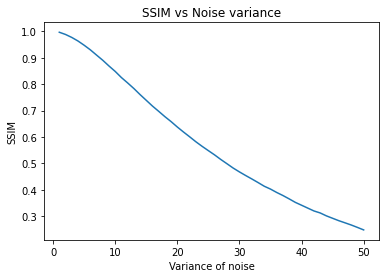

In [ ]:
# Plot SSIM

plt.plot(noiseVar,a_ssim_vals)
plt.xlabel("Variance of noise")
plt.ylabel("SSIM")
plt.title("SSIM vs Noise variance")
plt.show()

SSIM decreases almost linearly with noise added.

# B. Gaussian low pass filtering with various variances

In [ ]:
# Create an array of variances for the gaussian LPF

gausVar = np.linspace(5,500,100)

psnr_vals = np.zeros(100)
ssim_vals = np.zeros(100)

for i in range(100):
  gausImg = GLPF(awgn_img,gausVar[i])
  psnr = PSNR(gausImg,inputImg)
  ssim = SSIM(gausImg,inputImg)
  psnr_vals[i] = psnr
  ssim_vals[i] = ssim

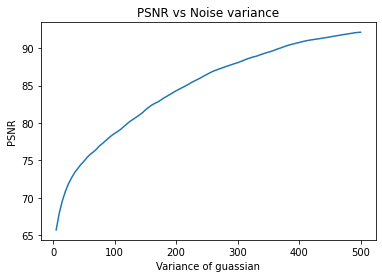

In [ ]:
# Plot PSNR

plt.plot(gausVar,psnr_vals)
plt.xlabel("Variance of guassian")
plt.ylabel("PSNR")
plt.title("PSNR vs Noise variance")
plt.show()

It seems that the PSNR saturates at around 85 - which is logically expected since as the variance becomes larger and larger, the filter covers almost all of the frequencies present in the noisy image and PSNR tends to what it was for the unblurred noisy image.

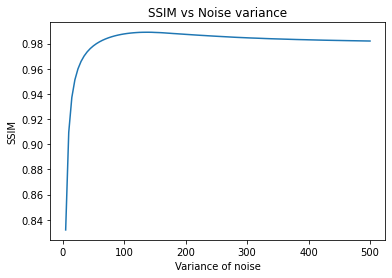

In [ ]:
# Plot SSIM

plt.plot(gausVar,ssim_vals)
plt.xlabel("Variance of noise")
plt.ylabel("SSIM")
plt.title("SSIM vs Noise variance")
plt.show()

We get a peak in SSIM at around variance of 110, after which it stays somewhat constant.

# C. The two thresholding methods, where threshold is given by λ = 𝜎sqrt(2log𝑛2) (as suggested by Donoho et al.), where 𝜎 is noise variance,and 𝑛 is window size

# I. Hard thresholding

In [ ]:
# Create an array of variances from 0 to 10
noiseVar = np.linspace(1,50,50)

n_vals = [1,3,5,7,9,11] # Window_sizes

c_psnr_vals = np.zeros((6,50))
c_ssim_vals = np.zeros((6,50))

for i in range(6):
  n = n_vals[i]
  for j in range(50):
    var = noiseVar[j]
    lambda_t = var*np.sqrt(4*np.log(n))
    noisyImg = AWGN(inputImg,var)
    hard_thres = hard_thresh_denoise(noisyImg,lambda_t)
    psnr = PSNR(hard_thres,inputImg)
    ssim = SSIM(hard_thres,inputImg)
    c_psnr_vals[i][j] = psnr
    c_ssim_vals[i][j] = ssim



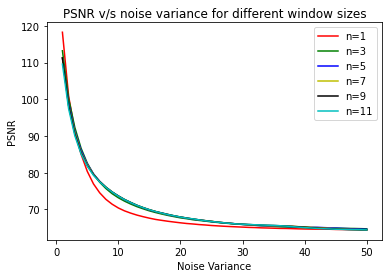

In [ ]:
# Plot PSNR
plt.plot(noiseVar,c_psnr_vals[0],color='r',label="n=1")
plt.plot(noiseVar,c_psnr_vals[1],color='g',label="n=3")
plt.plot(noiseVar,c_psnr_vals[2],color='b',label="n=5")
plt.plot(noiseVar,c_psnr_vals[3],color='y',label="n=7")
plt.plot(noiseVar,c_psnr_vals[4],color='k',label="n=9")
plt.plot(noiseVar,c_psnr_vals[5],color='c',label="n=11")


plt.legend()
plt.xlabel("Noise Variance")
plt.ylabel("PSNR")
plt.title("PSNR v/s noise variance for different window sizes")
plt.show()

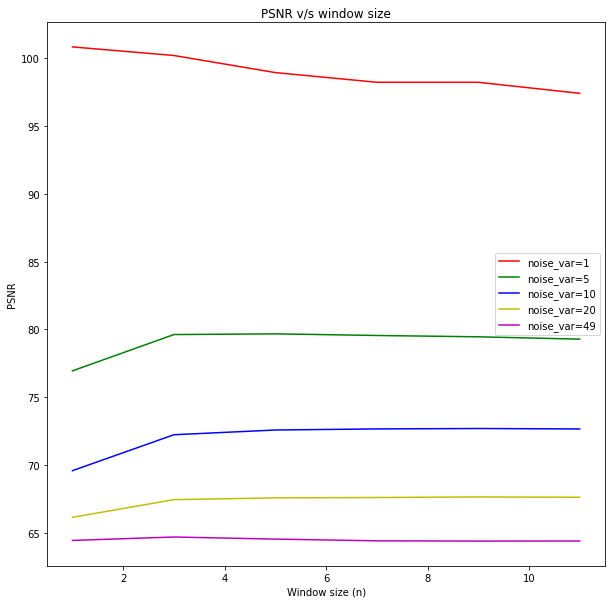

In [ ]:
# Plot PSNR - this time we fix the noiseVar and just plot the impact of window size
psnr_1 = np.array([c_psnr_vals[0][1],
                   c_psnr_vals[1][1],
                   c_psnr_vals[2][1],
                   c_psnr_vals[3][1],
                   c_psnr_vals[4][1],
                   c_psnr_vals[5][1]]) # values of PSNR for different n at noise variance = 5

psnr_5 = np.array([c_psnr_vals[0][5],
                   c_psnr_vals[1][5],
                   c_psnr_vals[2][5],
                   c_psnr_vals[3][5],
                   c_psnr_vals[4][5],
                   c_psnr_vals[5][5]]) # values of PSNR for different n at noise variance = 5

psnr_10 = np.array([c_psnr_vals[0][10],
                   c_psnr_vals[1][10],
                   c_psnr_vals[2][10],
                   c_psnr_vals[3][10],
                   c_psnr_vals[4][10],
                   c_psnr_vals[5][10]]) # values of PSNR for different n at noise variance = 10

psnr_20 = np.array([c_psnr_vals[0][20],
                   c_psnr_vals[1][20],
                   c_psnr_vals[2][20],
                   c_psnr_vals[3][20],
                   c_psnr_vals[4][20],
                   c_psnr_vals[5][20]]) # values of PSNR for different n at noise variance = 20

psnr_49 = np.array([c_psnr_vals[0][49],
                   c_psnr_vals[1][49],
                   c_psnr_vals[2][49],
                   c_psnr_vals[3][49],
                   c_psnr_vals[4][49],
                   c_psnr_vals[5][49]]) # values of PSNR for different n at noise variance = 49

f =  plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.plot(n_vals,psnr_1,color="r",label="noise_var=1")
plt.plot(n_vals,psnr_5,color="g",label="noise_var=5")
plt.plot(n_vals,psnr_10,color="b",label="noise_var=10")
plt.plot(n_vals,psnr_20,color="y",label="noise_var=20")
plt.plot(n_vals,psnr_49,color="m",label="noise_var=49")
plt.xlabel("Window size (n)")
plt.ylabel("PSNR")
plt.title("PSNR v/s window size")
plt.legend()
plt.show()

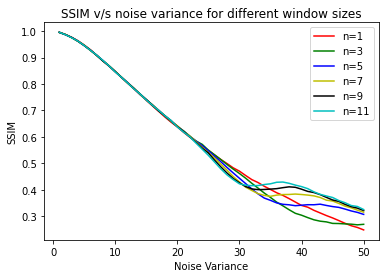

In [ ]:
# Plot SSIM
noiseVar = np.linspace(1,50,50)
plt.plot(noiseVar,c_ssim_vals[0],color='r',label="n=1")
plt.plot(noiseVar,c_ssim_vals[1],color='g',label="n=3")
plt.plot(noiseVar,c_ssim_vals[2],color='b',label="n=5")
plt.plot(noiseVar,c_ssim_vals[3],color='y',label="n=7")
plt.plot(noiseVar,c_ssim_vals[4],color='k',label="n=9")
plt.plot(noiseVar,c_ssim_vals[5],color='c',label="n=11")


plt.legend()
plt.xlabel("Noise Variance")
plt.ylabel("SSIM")
plt.title("SSIM v/s noise variance for different window sizes")
plt.show()

Initially, all of them have similar SSIM but as the noise variance begins to increase, we can clearly see that larger window sizes give us better SSIM values.

# II. Soft thresholding

In [ ]:
# Create an array of varainces from 0 to 10
noiseVar = np.linspace(1,50,50)

n_vals = [1,3,5,7,9,11] # Window_sizes

iic_psnr_vals = np.zeros((6,50))
iic_ssim_vals = np.zeros((6,50))

for i in range(6):
  n = n_vals[i]
  for j in range(50):
    var = noiseVar[j]
    lambda_t = var*np.sqrt(4*np.log(n))
    noisyImg = AWGN(inputImg,var)
    soft_thres = soft_thresh_denoise(noisyImg,lambda_t)
    psnr = PSNR(soft_thres,inputImg)
    ssim = SSIM(soft_thres,inputImg)
    iic_psnr_vals[i][j] = psnr
    iic_ssim_vals[i][j] = ssim

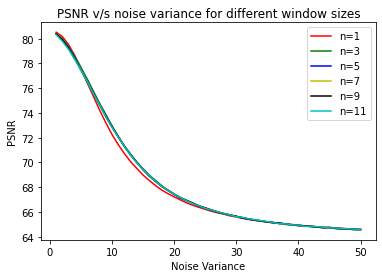

In [ ]:
# Plot PSNR
plt.plot(noiseVar,iic_psnr_vals[0],color='r',label="n=1")
plt.plot(noiseVar,iic_psnr_vals[1],color='g',label="n=3")
plt.plot(noiseVar,iic_psnr_vals[2],color='b',label="n=5")
plt.plot(noiseVar,iic_psnr_vals[3],color='y',label="n=7")
plt.plot(noiseVar,iic_psnr_vals[4],color='k',label="n=9")
plt.plot(noiseVar,iic_psnr_vals[5],color='c',label="n=11")


plt.legend()
plt.xlabel("Noise Variance")
plt.ylabel("PSNR")
plt.title("PSNR v/s noise variance for different window sizes")
plt.show()

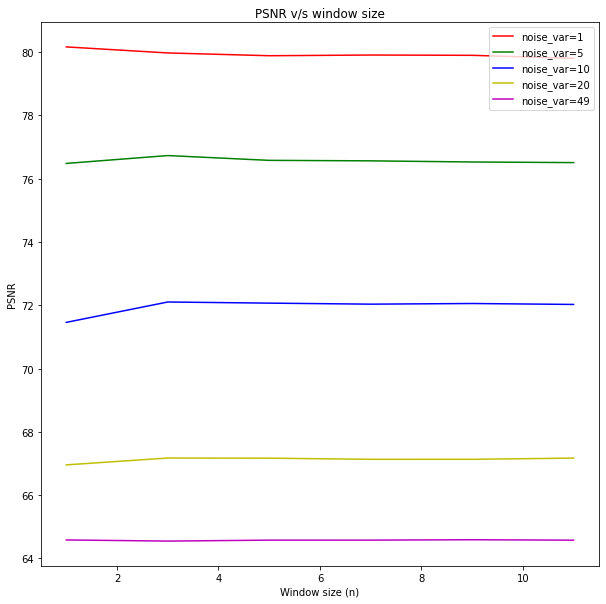

In [ ]:
# Plot PSNR - this time we fix the noiseVar and just plot the impact of window size
psnr_1 = np.array([iic_psnr_vals[0][1],
                   iic_psnr_vals[1][1],
                   iic_psnr_vals[2][1],
                   iic_psnr_vals[3][1],
                   iic_psnr_vals[4][1],
                   iic_psnr_vals[5][1]]) # values of PSNR for different n at noise variance = 5

psnr_5 = np.array([iic_psnr_vals[0][5],
                   iic_psnr_vals[1][5],
                   iic_psnr_vals[2][5],
                   iic_psnr_vals[3][5],
                   iic_psnr_vals[4][5],
                   iic_psnr_vals[5][5]]) # values of PSNR for different n at noise variance = 5

psnr_10 = np.array([iic_psnr_vals[0][10],
                   iic_psnr_vals[1][10],
                   iic_psnr_vals[2][10],
                   iic_psnr_vals[3][10],
                   iic_psnr_vals[4][10],
                   iic_psnr_vals[5][10]]) # values of PSNR for different n at noise variance = 10

psnr_20 = np.array([iic_psnr_vals[0][20],
                   iic_psnr_vals[1][20],
                   iic_psnr_vals[2][20],
                   iic_psnr_vals[3][20],
                   iic_psnr_vals[4][20],
                   iic_psnr_vals[5][20]]) # values of PSNR for different n at noise variance = 20

psnr_49 = np.array([iic_psnr_vals[0][49],
                   iic_psnr_vals[1][49],
                   iic_psnr_vals[2][49],
                   iic_psnr_vals[3][49],
                   iic_psnr_vals[4][49],
                   iic_psnr_vals[5][49]]) # values of PSNR for different n at noise variance = 49

f =  plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.plot(n_vals,psnr_1,color="r",label="noise_var=1")
plt.plot(n_vals,psnr_5,color="g",label="noise_var=5")
plt.plot(n_vals,psnr_10,color="b",label="noise_var=10")
plt.plot(n_vals,psnr_20,color="y",label="noise_var=20")
plt.plot(n_vals,psnr_49,color="m",label="noise_var=49")
plt.xlabel("Window size (n)")
plt.ylabel("PSNR")
plt.title("PSNR v/s window size")
plt.legend()
plt.show()

# D. The method given by Chen et al

In [ ]:
# Create an array of varainces from 0 to 10
noiseVar = np.linspace(1,51,6)

n_vals = [1,3,5,7,9,11] # Window_sizes

d_psnr_vals = np.zeros((6,6))
d_ssim_vals = np.zeros((6,6))

for i in range(6):
  n = n_vals[i]
  for j in range(6):
    var = noiseVar[j]
    lambda_t = var*np.sqrt(4*np.log(n))
    noisyImg = AWGN(inputImg,var)
    neighShrinkImg = neighShrink(noisyImg,var,n)
    psnr = PSNR(neighShrinkImg,inputImg)
    ssim = SSIM(neighShrinkImg,inputImg)
    d_psnr_vals[i][j] = psnr
    d_ssim_vals[i][j] = ssim
    if j%5==0: print("Progress: ",(i,j)) # Added this line to keep track of progress since the code runs pretty slow

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: RuntimeWarning: invalid value encountered in double_scalars


Progress:  (0, 0)
Progress:  (0, 5)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in double_scalars


Progress:  (1, 0)
Progress:  (1, 5)
Progress:  (2, 0)
Progress:  (2, 5)
Progress:  (3, 0)
Progress:  (3, 5)
Progress:  (4, 0)
Progress:  (4, 5)
Progress:  (5, 0)
Progress:  (5, 5)


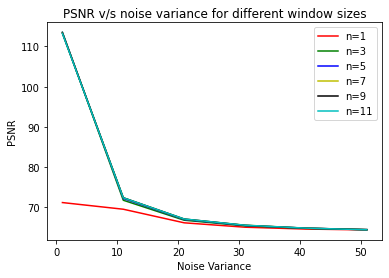

In [ ]:
# Plot PSNR
f = plt.figure()
plt.plot(noiseVar,d_psnr_vals[0],color='r',label="n=1")
plt.plot(noiseVar,d_psnr_vals[1],color='g',label="n=3")
plt.plot(noiseVar,d_psnr_vals[2],color='b',label="n=5")
plt.plot(noiseVar,d_psnr_vals[3],color='y',label="n=7")
plt.plot(noiseVar,d_psnr_vals[4],color='k',label="n=9")
plt.plot(noiseVar,d_psnr_vals[5],color='c',label="n=11")


plt.legend()
plt.xlabel("Noise Variance")
plt.ylabel("PSNR")
plt.title("PSNR v/s noise variance for different window sizes")
plt.show()

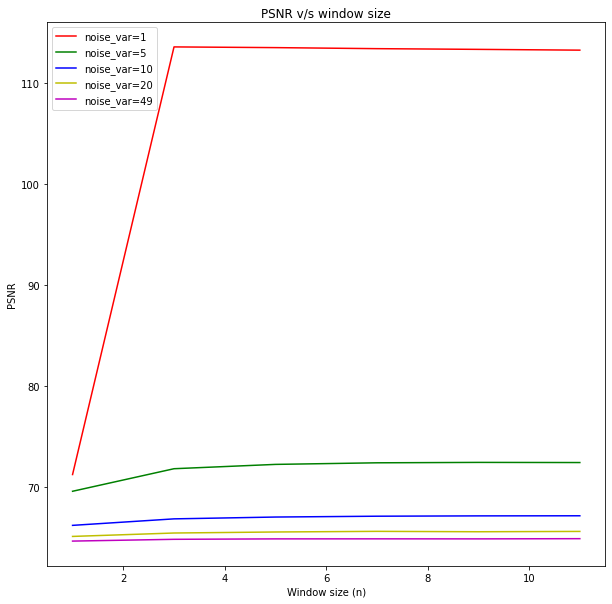

In [ ]:
# Plot PSNR - this time we fix the noiseVar and just plot the impact of window size
psnr_1 = np.array([d_psnr_vals[0][0],
                   d_psnr_vals[1][0],
                   d_psnr_vals[2][0],
                   d_psnr_vals[3][0],
                   d_psnr_vals[4][0],
                   d_psnr_vals[5][0]]) # values of PSNR for different n at noise variance = 5

psnr_5 = np.array([d_psnr_vals[0][1],
                   d_psnr_vals[1][1],
                   d_psnr_vals[2][1],
                   d_psnr_vals[3][1],
                   d_psnr_vals[4][1],
                   d_psnr_vals[5][1]]) # values of PSNR for different n at noise variance = 5

psnr_10 = np.array([d_psnr_vals[0][2],
                   d_psnr_vals[1][2],
                   d_psnr_vals[2][2],
                   d_psnr_vals[3][2],
                   d_psnr_vals[4][2],
                   d_psnr_vals[5][2]]) # values of PSNR for different n at noise variance = 10

psnr_20 = np.array([d_psnr_vals[0][3],
                   d_psnr_vals[1][3],
                   d_psnr_vals[2][3],
                   d_psnr_vals[3][3],
                   d_psnr_vals[4][3],
                   d_psnr_vals[5][3]]) # values of PSNR for different n at noise variance = 20

psnr_49 = np.array([d_psnr_vals[0][4],
                   d_psnr_vals[1][4],
                   d_psnr_vals[2][4],
                   d_psnr_vals[3][4],
                   d_psnr_vals[4][4],
                   d_psnr_vals[5][4]]) # values of PSNR for different n at noise variance = 49

f =  plt.figure()
f.set_figwidth(10)
f.set_figheight(10)
plt.plot(n_vals,psnr_1,color="r",label="noise_var=1")
plt.plot(n_vals,psnr_5,color="g",label="noise_var=5")
plt.plot(n_vals,psnr_10,color="b",label="noise_var=10")
plt.plot(n_vals,psnr_20,color="y",label="noise_var=20")
plt.plot(n_vals,psnr_49,color="m",label="noise_var=49")
plt.xlabel("Window size (n)")
plt.ylabel("PSNR")
plt.title("PSNR v/s window size")
plt.legend()
plt.show()

As mentioned in the paper, 3 and 5 seem to be the best window sizes.

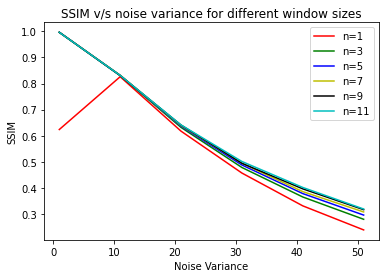

In [ ]:
# Plot SSIM
noiseVar = np.linspace(1,51,6)
f.set_figwidth(10)
f.set_figheight(10)
plt.plot(noiseVar,d_ssim_vals[0],color='r',label="n=1")
plt.plot(noiseVar,d_ssim_vals[1],color='g',label="n=3")
plt.plot(noiseVar,d_ssim_vals[2],color='b',label="n=5")
plt.plot(noiseVar,d_ssim_vals[3],color='y',label="n=7")
plt.plot(noiseVar,d_ssim_vals[4],color='k',label="n=9")
plt.plot(noiseVar,d_ssim_vals[5],color='c',label="n=11")


plt.legend()
plt.xlabel("Noise Variance")
plt.ylabel("SSIM")
plt.title("SSIM v/s noise variance for different window sizes")
plt.show()

# E. When the method is independently applied to RGB channels, versus when the method is applied to I channel of HSI transform

The above case was for the RGB values. Now let's repeat the calculations for I channel of HSI.

In [ ]:
# Create an array of varainces from 0 to 10
noiseVar = np.linspace(1,51,6)

n_vals = [1,3,5,7,9,11] # Window_sizes

e_psnr_vals = np.zeros((6,6))
e_ssim_vals = np.zeros((6,6))

for i in range(6):
  n = n_vals[i]
  for j in range(6):
    var = noiseVar[j]
    lambda_t = var*np.sqrt(4*np.log(n))
    noisyImg = AWGN(inputImg,var)
    hsvImg = cv2.cvtColor(noisyImg, cv2.COLOR_BGR2HSV)
    neighShrinkImg_V = neighShrink(hsvImg[:,:,2],var,n) # Extract the V channel of the HSV image
    neighShrinkImg = hsvImg.copy()
    neighShrinkImg[:,:,2] = neighShrinkImg_V
    # Convert neighShrinkImg back to HSV
    neighShrinkImg = cv2.cvtColor(noisyImg, cv2.COLOR_HSV2BGR)
    psnr = PSNR(neighShrinkImg,inputImg)
    ssim = SSIM(neighShrinkImg,inputImg)
    e_psnr_vals[i][j] = psnr
    e_ssim_vals[i][j] = ssim
    if j%5==0: print("Progress: ",(i,j)) # Added this line to keep track of progress since the code runs pretty slow

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:80: RuntimeWarning: invalid value encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: invalid value encountered in double_scalars


Progress:  (0, 0)
Progress:  (0, 5)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:80: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:93: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:106: RuntimeWarning: divide by zero encountered in double_scalars


Progress:  (1, 0)
Progress:  (1, 5)
Progress:  (2, 0)
Progress:  (2, 5)
Progress:  (3, 0)
Progress:  (3, 5)
Progress:  (4, 0)
Progress:  (4, 5)
Progress:  (5, 0)
Progress:  (5, 5)


To enable better comparision I will plot the graphs for PSNR for the RGB as well as HSV case side by side.

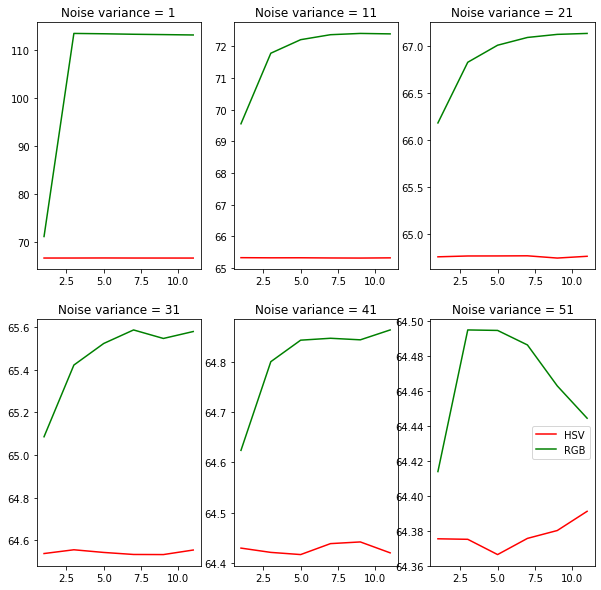

In [ ]:
# Plot PSNR

# Initialise the subplot function using number of rows and columns
figure, axis = plt.subplots(2, 3)
figure.set_figwidth(10)
figure.set_figheight(10)

axis[0, 0].plot(n_vals, np.array([e_psnr_vals[0][0],
                   e_psnr_vals[1][0],
                   e_psnr_vals[2][0],
                   e_psnr_vals[3][0],
                   e_psnr_vals[4][0],
                   e_psnr_vals[5][0]]),color="r",label="HSV")
axis[0, 0].plot(n_vals, np.array([d_psnr_vals[0][0],
                   d_psnr_vals[1][0],
                   d_psnr_vals[2][0],
                   d_psnr_vals[3][0],
                   d_psnr_vals[4][0],
                   d_psnr_vals[5][0]]),color="g",label="RGB")
axis[0, 0].set_title("Noise variance = 1")

axis[0, 1].plot(n_vals, np.array([e_psnr_vals[0][1],
                   e_psnr_vals[1][1],
                   e_psnr_vals[2][1],
                   e_psnr_vals[3][1],
                   e_psnr_vals[4][1],
                   e_psnr_vals[5][1]]),color="r",label="HSV")
axis[0, 1].plot(n_vals, np.array([d_psnr_vals[0][1],
                   d_psnr_vals[1][1],
                   d_psnr_vals[2][1],
                   d_psnr_vals[3][1],
                   d_psnr_vals[4][1],
                   d_psnr_vals[5][1]]),color="g",label="RGB")
axis[0, 1].set_title("Noise variance = 11")

axis[0, 2].plot(n_vals, np.array([e_psnr_vals[0][2],
                   e_psnr_vals[1][2],
                   e_psnr_vals[2][2],
                   e_psnr_vals[3][2],
                   e_psnr_vals[4][2],
                   e_psnr_vals[5][2]]),color="r",label="HSV")
axis[0, 2].plot(n_vals, np.array([d_psnr_vals[0][2],
                   d_psnr_vals[1][2],
                   d_psnr_vals[2][2],
                   d_psnr_vals[3][2],
                   d_psnr_vals[4][2],
                   d_psnr_vals[5][2]]),color="g",label="RGB")
axis[0, 2].set_title("Noise variance = 21")

axis[1, 0].plot(n_vals, np.array([e_psnr_vals[0][3],
                   e_psnr_vals[1][3],
                   e_psnr_vals[2][3],
                   e_psnr_vals[3][3],
                   e_psnr_vals[4][3],
                   e_psnr_vals[5][3]]),color="r",label="HSV")
axis[1, 0].plot(n_vals, np.array([d_psnr_vals[0][3],
                   d_psnr_vals[1][3],
                   d_psnr_vals[2][3],
                   d_psnr_vals[3][3],
                   d_psnr_vals[4][3],
                   d_psnr_vals[5][3]]),color="g",label="RGB")
axis[1, 0].set_title("Noise variance = 31")

axis[1, 1].plot(n_vals, np.array([e_psnr_vals[0][4],
                   e_psnr_vals[1][4],
                   e_psnr_vals[2][4],
                   e_psnr_vals[3][4],
                   e_psnr_vals[4][4],
                   e_psnr_vals[5][4]]),color="r",label="HSV")
axis[1, 1].plot(n_vals, np.array([d_psnr_vals[0][4],
                   d_psnr_vals[1][4],
                   d_psnr_vals[2][4],
                   d_psnr_vals[3][4],
                   d_psnr_vals[4][4],
                   d_psnr_vals[5][4]]),color="g",label="RGB")
axis[1, 1].set_title("Noise variance = 41")

axis[1, 2].plot(n_vals, np.array([e_psnr_vals[0][5],
                   e_psnr_vals[1][5],
                   e_psnr_vals[2][5],
                   e_psnr_vals[3][5],
                   e_psnr_vals[4][5],
                   e_psnr_vals[5][5]]),color="r",label="HSV")
axis[1, 2].plot(n_vals, np.array([d_psnr_vals[0][5],
                   d_psnr_vals[1][5],
                   d_psnr_vals[2][5],
                   d_psnr_vals[3][5],
                   d_psnr_vals[4][5],
                   d_psnr_vals[5][5]]),color="g",label="RGB")
axis[1, 2].set_title("Noise variance = 51")

# Combine all the operations and display
plt.legend()
plt.show()



plt.show()

Clearly, using RGB gives better results as compared to HSV.

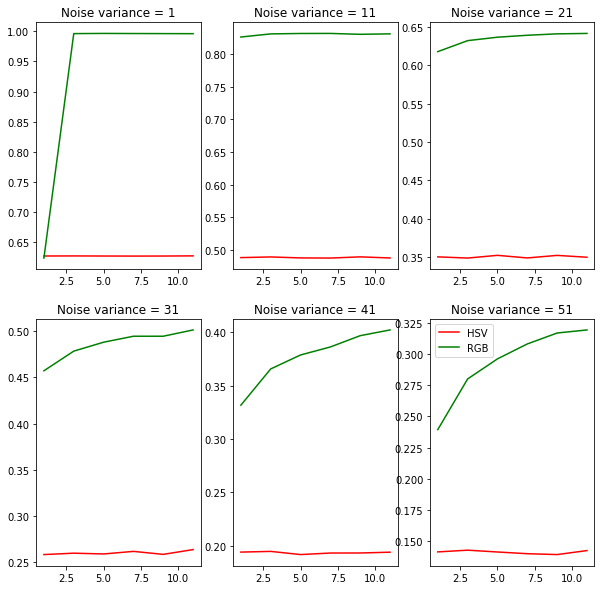

In [ ]:
# Plot SSIM

# Initialise the subplot function using number of rows and columns
figure, axis = plt.subplots(2, 3)
figure.set_figwidth(10)
figure.set_figheight(10)

axis[0, 0].plot(n_vals, np.array([e_ssim_vals[0][0],
                   e_ssim_vals[1][0],
                   e_ssim_vals[2][0],
                   e_ssim_vals[3][0],
                   e_ssim_vals[4][0],
                   e_ssim_vals[5][0]]),color="r",label="HSV")
axis[0, 0].plot(n_vals, np.array([d_ssim_vals[0][0],
                   d_ssim_vals[1][0],
                   d_ssim_vals[2][0],
                   d_ssim_vals[3][0],
                   d_ssim_vals[4][0],
                   d_ssim_vals[5][0]]),color="g",label="RGB")
axis[0, 0].set_title("Noise variance = 1")

axis[0, 1].plot(n_vals, np.array([e_ssim_vals[0][1],
                   e_ssim_vals[1][1],
                   e_ssim_vals[2][1],
                   e_ssim_vals[3][1],
                   e_ssim_vals[4][1],
                   e_ssim_vals[5][1]]),color="r",label="HSV")
axis[0, 1].plot(n_vals, np.array([d_ssim_vals[0][1],
                   d_ssim_vals[1][1],
                   d_ssim_vals[2][1],
                   d_ssim_vals[3][1],
                   d_ssim_vals[4][1],
                   d_ssim_vals[5][1]]),color="g",label="RGB")
axis[0, 1].set_title("Noise variance = 11")

axis[0, 2].plot(n_vals, np.array([e_ssim_vals[0][2],
                   e_ssim_vals[1][2],
                   e_ssim_vals[2][2],
                   e_ssim_vals[3][2],
                   e_ssim_vals[4][2],
                   e_ssim_vals[5][2]]),color="r",label="HSV")
axis[0, 2].plot(n_vals, np.array([d_ssim_vals[0][2],
                   d_ssim_vals[1][2],
                   d_ssim_vals[2][2],
                   d_ssim_vals[3][2],
                   d_ssim_vals[4][2],
                   d_ssim_vals[5][2]]),color="g",label="RGB")
axis[0, 2].set_title("Noise variance = 21")

axis[1, 0].plot(n_vals, np.array([e_ssim_vals[0][3],
                   e_ssim_vals[1][3],
                   e_ssim_vals[2][3],
                   e_ssim_vals[3][3],
                   e_ssim_vals[4][3],
                   e_ssim_vals[5][3]]),color="r",label="HSV")
axis[1, 0].plot(n_vals, np.array([d_ssim_vals[0][3],
                   d_ssim_vals[1][3],
                   d_ssim_vals[2][3],
                   d_ssim_vals[3][3],
                   d_ssim_vals[4][3],
                   d_ssim_vals[5][3]]),color="g",label="RGB")
axis[1, 0].set_title("Noise variance = 31")

axis[1, 1].plot(n_vals, np.array([e_ssim_vals[0][4],
                   e_ssim_vals[1][4],
                   e_ssim_vals[2][4],
                   e_ssim_vals[3][4],
                   e_ssim_vals[4][4],
                   e_ssim_vals[5][4]]),color="r",label="HSV")
axis[1, 1].plot(n_vals, np.array([d_ssim_vals[0][4],
                   d_ssim_vals[1][4],
                   d_ssim_vals[2][4],
                   d_ssim_vals[3][4],
                   d_ssim_vals[4][4],
                   d_ssim_vals[5][4]]),color="g",label="RGB")
axis[1, 1].set_title("Noise variance = 41")

axis[1, 2].plot(n_vals, np.array([e_ssim_vals[0][5],
                   e_ssim_vals[1][5],
                   e_ssim_vals[2][5],
                   e_ssim_vals[3][5],
                   e_ssim_vals[4][5],
                   e_ssim_vals[5][5]]),color="r",label="HSV")
axis[1, 2].plot(n_vals, np.array([d_ssim_vals[0][5],
                   d_ssim_vals[1][5],
                   d_ssim_vals[2][5],
                   d_ssim_vals[3][5],
                   d_ssim_vals[4][5],
                   d_ssim_vals[5][5]]),color="g",label="RGB")
axis[1, 2].set_title("Noise variance = 51")

# Combine all the operations and display
plt.legend()
plt.show()



plt.show()

Even for SSIM, the RGB method surpasses the HSV method by considerable margin.

# Q 4 Comparing the above methods on real noisy images by guessing the noise variance

In [ ]:
!wget 'https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/balloons_noisy.png'

--2022-10-15 17:36:52--  https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/balloons_noisy.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 693250 (677K) [image/png]
Saving to: ‘balloons_noisy.png.1’

balloons_noisy.png. 100%[===================>] 677.00K  --.-KB/s    in 0.03s   

2022-10-15 17:36:53 (19.7 MB/s) - ‘balloons_noisy.png.1’ saved [693250/693250]



In [ ]:
real_noisy1 = cv2.imread('balloons_noisy.png.1')
cv2_imshow(real_noisy1)

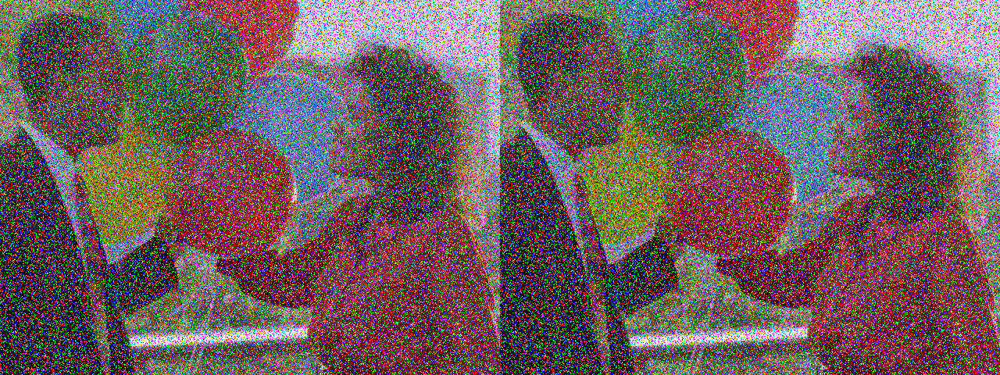

In [ ]:
noiseVar = [2, 5, 8, 15, 20 ]
for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  hard_thres = hard_thresh_denoise(real_noisy1, lambda_t)
  concat = np.concatenate((real_noisy1, hard_thres), axis = 1 )
  cv2_imshow(concat)

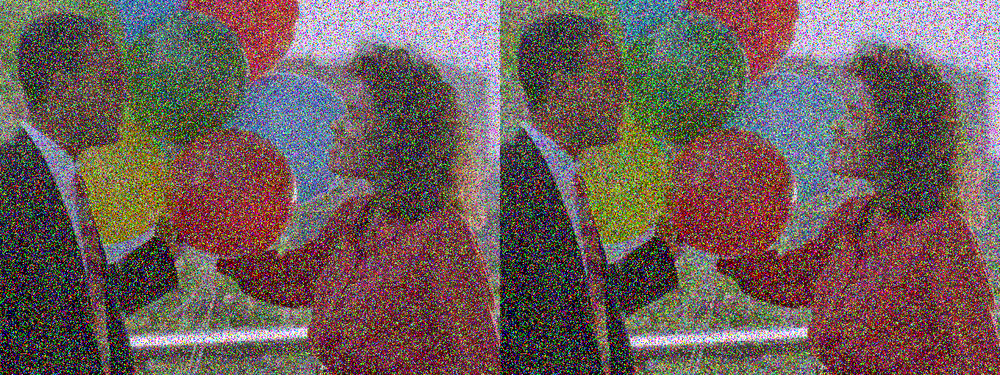

In [ ]:

for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  soft_thresh = soft_thresh_denoise(real_noisy1,lambda_t)
  concat = np.concatenate((real_noisy1, soft_thres), axis = 1 )
  cv2_imshow(concat)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in double_scalars


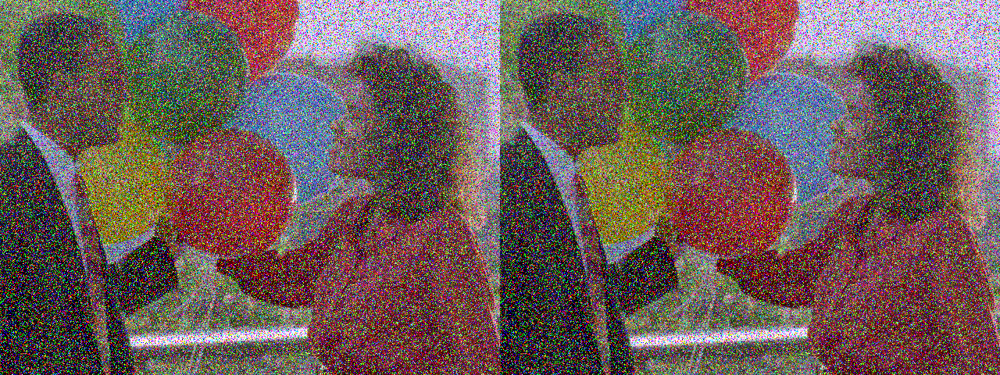

In [ ]:

for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  neighShrinkImg = neighShrink(real_noisy1,lambda_t, n = 5)
  concat = np.concatenate((real_noisy1, neighShrinkImg), axis = 1 )
  cv2_imshow(concat)

--2022-10-16 13:47:48--  https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/mouse_noisy.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 322989 (315K) [image/jpeg]
Saving to: ‘mouse_noisy.jpg.1’

mouse_noisy.jpg.1   100%[===================>] 315.42K  --.-KB/s    in 0.04s   

2022-10-16 13:47:48 (7.55 MB/s) - ‘mouse_noisy.jpg.1’ saved [322989/322989]



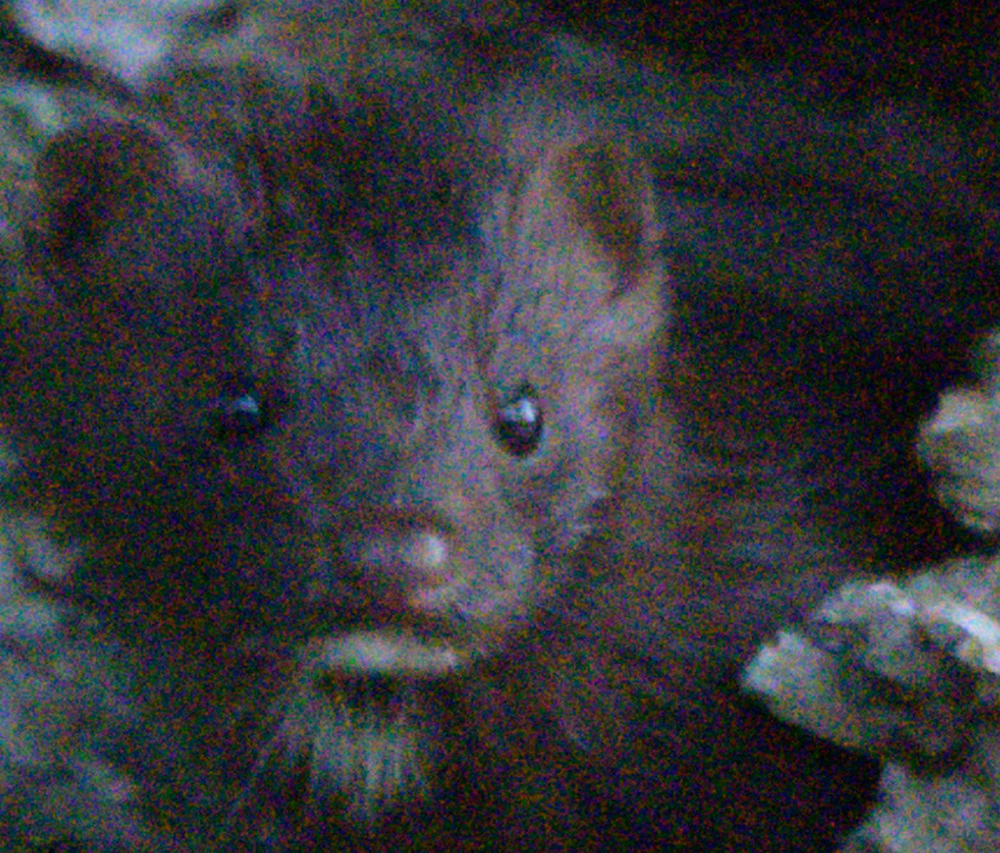

In [ ]:
!wget 'https://raw.githubusercontent.com/Mayankag020/EE-610-Assignments/main/mouse_noisy.jpg'
real_noisy2 = cv2.imread('mouse_noisy.jpg')
cv2_imshow(real_noisy2)

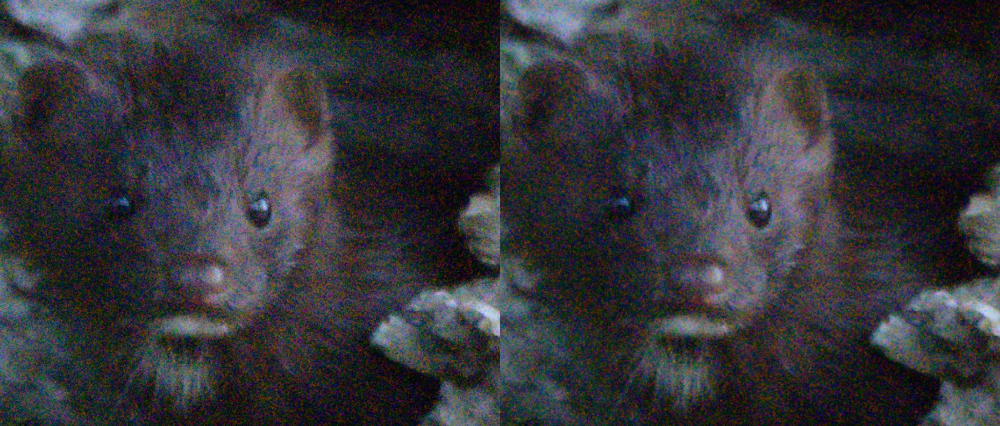

In [ ]:

for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  hard_thres = hard_thresh_denoise(real_noisy2,lambda_t)
  concat = np.concatenate((real_noisy2, hard_thres), axis = 1 )
  cv2_imshow(concat)

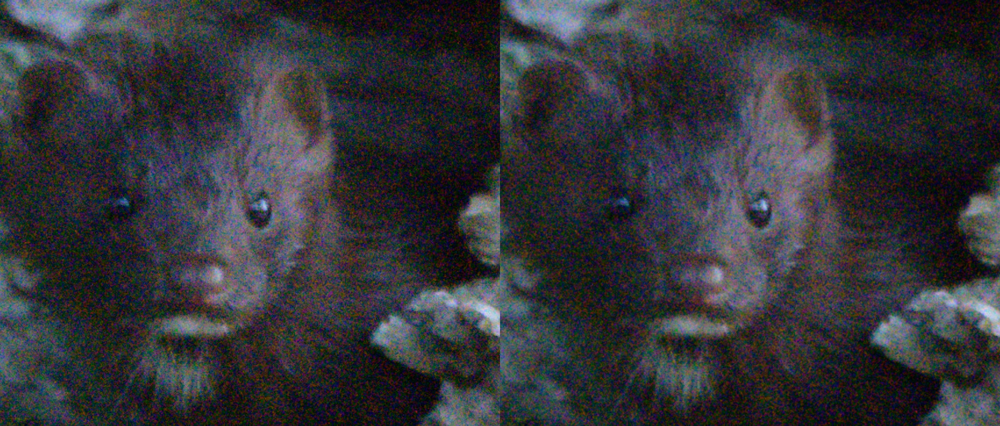

In [ ]:

for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  soft_thresh = soft_thresh_denoise(real_noisy2,lambda_t)
  concat = np.concatenate((real_noisy2, soft_thresh), axis = 1 )
  cv2_imshow(concat)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:41: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:53: RuntimeWarning: divide by zero encountered in double_scalars


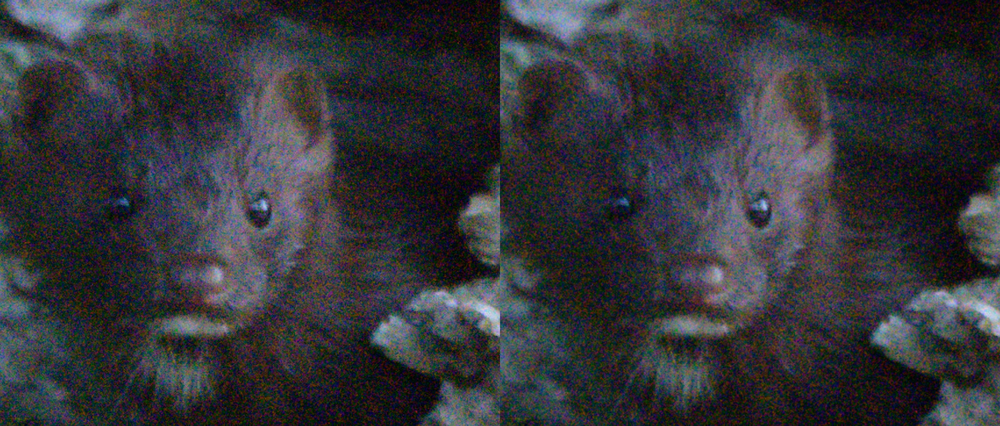

In [ ]:
for j in range(len(noiseVar)):
  var = noiseVar[j]
  lambda_t = var*np.sqrt(4*np.log(5))
  neighShrinkImg = neighShrink(real_noisy2,lambda_t, n = 5)
  concat = np.concatenate((real_noisy2, neighShrinkImg), axis = 1 )
  cv2_imshow(concat)
